### ______________________________________________________________________________

<div style="width:100%;text-align: center;">
    <img src="ensae.png" /> <br>
    Ecole nationale de la Statistique et de l'Analyse économique Pierre NDIAYE<br>ENSAE - Dakar
    <br>
    <br>
    ***************
    <br>
    <br>
    <strong>Projet de Machine Learning</strong>
    <br>
    <br>
    ***************
    <br>
</div>

<div style="width:100%;text-align: center;">
    <img src="seattle_image.png" style="width:35%;height:100%;" /> <br>
    <span style="font-size:20px;"><strong>SEA Building Energy Benchmarking : Prediction of Building Energy</strong></span>
</div>
    <br>
    <br>
<div style="display:flex;">
<div style="width:50%;text-align: left;">
   <span style="font-size:20px;">
           Présenté par : <br>
           Mansour Kama SANE <br>
           Sié Charles SOU <br>
           Ulrich DABIRE
    </span>
</div>

<div style="width:50%;text-align: right;">
   <span style="font-size:20px;">
           Sous l'encadrement de : <br>
           Mously DIAW
    </span>
</div>
</div>

### ______________________________________________________________________________

<br>
<br>
<br>
<p style="line-height: 1.8;"> Ce document a été élaboré suite au projet de Machine Learning qui nous a été donné dans le cadre du cours d'Initiation au Machine Learning. Notre travail porte sur <span style="color:blue;"><strong>la prédiction des énergies émises par les bâtiments dans la ville de Seattle<strong></span> </p>

## Introduction

<p>La ville de Seattle, à travers le programme d'analyse comparative de l'énergie des bâtiments de Seattle s'est fixé comme objectif de ville neutre en émissions de carbone en 2050. Pour cela, elle s’intéresse de près aux émissions des bâtiments non destinés à l’habitation. Elle exige des propriétaires de bâtiments non résidentiels et multifamiliaux (20 000 pieds carrés ou plus) qu'ils suivent les performances énergétiques et qu'ils présentent un rapport annuel à la ville de Seattle. L'analyse comparative annuelle, le rapport et la divulgation de la performance des bâtiments sont des éléments fondamentaux de la création d'une plus grande valeur marchande pour l'efficacité énergétique.(Source: <a href="https://data.seattle.gov/browse?q=2015%20Building%20Energy%20Benchmarking&sortBy=relevance" > cliquer ici </a>)</p>
Notre travail consistera, dès lors, à prédire les émissions de CO2 et la consommation totale d’énergie de bâtiments pour lesquels elles n’ont pas encore été mesurées en nous servant des données de 2019 et de 2020. Pour ce faire, le plan suivant a été adopté.

# Sommaire

#### Le sommaire à mettre

# Preprocessing

In [1]:
## Installation de package
##!pip install fancyimpute
## Packages load
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import fancyimpute
from fancyimpute import KNN
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder
from sklearn.impute import KNNImputer

#### Importation des deux bases (2019 et 2020)

In [2]:
data_2019=pd.read_csv("data/2019_Building_Energy_Benchmarking.csv")
data_2020=pd.read_csv("data/2020_Building_Energy_Benchmarking.csv")

In [3]:
## Voir les dimensions des deux bases
print('2019 :',data_2019.shape, '2020 :',data_2020.shape)

2019 : (3581, 42) 2020 : (3628, 42)


<p>Nous avons 42 variables dans toutes les deux bases. Mais, nous avons 3581 lignes en 2019 et 3628 lignes en 2020. Ce qui peut signifier que des bâtiments se sont ajoutés en 2020.</p>

#### Comparaison des columns des deux bases

In [4]:
## Nous utiliserons la fonction suivante pour comparer les columns des deux bases
def columns_comparison(data1,data2):
    Data1Columns = list(data1.columns) ## Have data1 columns
    Data2Columns = list(data2.columns) ## Have data2 columns
    Data1ColumnsDiff=[] #columns in Data1 and not in Data2
    Data2ColumnsDiff=[] #columns in Data2 and not in Data1
    SimilarColumns=[]
    for i in Data2Columns:
        if i in Data1Columns:
            SimilarColumns.append(i) ## Similar columns appending
        else:
            Data2ColumnsDiff.append(i) ## Differents columns appending
    for i in Data1Columns:
        if i not in Data2Columns:
            Data1ColumnsDiff.append(i)
    print('2019 :',Data1ColumnsDiff, '2020 :',Data2ColumnsDiff)

In [5]:
columns_comparison(data_2019,data_2020)

2019 : ['PrimaryPropertyType'] 2020 : ['NumberofBuildings']


<p> Puisque ces variables ne seront pas utiles dans la suite, nous les supprimerons.</p>

### Comparaison des nombres de lignes

In [682]:
data_2020.shape[0]-data_2019.shape[0]

47

<div>Il y a 47 buildings qui sont nouvellement enregistré entre 2019 et 2020</div>

### Concatation des deux bases (2019 & 2020)

In [6]:
MergedData = pd.concat([data_2019,data_2020])

In [7]:
MergedData.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7209 entries, 0 to 3627
Data columns (total 43 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   OSEBuildingID                    7209 non-null   int64  
 1   DataYear                         7209 non-null   int64  
 2   BuildingName                     7209 non-null   object 
 3   BuildingType                     7209 non-null   object 
 4   TaxParcelIdentificationNumber    7209 non-null   object 
 5   Address                          7209 non-null   object 
 6   City                             7207 non-null   object 
 7   State                            7207 non-null   object 
 8   ZipCode                          7098 non-null   float64
 9   Latitude                         7205 non-null   float64
 10  Longitude                        7205 non-null   float64
 11  Neighborhood                     7205 non-null   object 
 12  CouncilDistrictCode 

In [8]:
MergedData.isnull().sum().sort_values(ascending=False)

ThirdLargestPropertyUseTypeGFA     5831
ThirdLargestPropertyUseType        5831
PrimaryPropertyType                3693
NumberofBuildings                  3581
SecondLargestPropertyUseTypeGFA    3391
SecondLargestPropertyUseType       3391
ENERGYSTARScore                    2016
SourceEUIWN(kBtu/sf)                305
SiteEnergyUse(kBtu)                 305
SiteEUIWN(kBtu/sf)                  305
SourceEUI(kBtu/sf)                  246
SiteEnergyUseWN(kBtu)               246
SiteEUI(kBtu/sf)                    246
EPAPropertyType                     160
LargestPropertyUseType              116
LargestPropertyUseTypeGFA           116
ZipCode                             111
GHGEmissionsIntensity                35
TotalGHGEmissions                    35
NaturalGas(kBtu)                     35
Electricity(kBtu)                    35
CouncilDistrictCode                  31
Latitude                              4
Neighborhood                          4
Longitude                             4


<AxesSubplot:title={'center':'Proportion de NaN de chaque variable (%)'}>

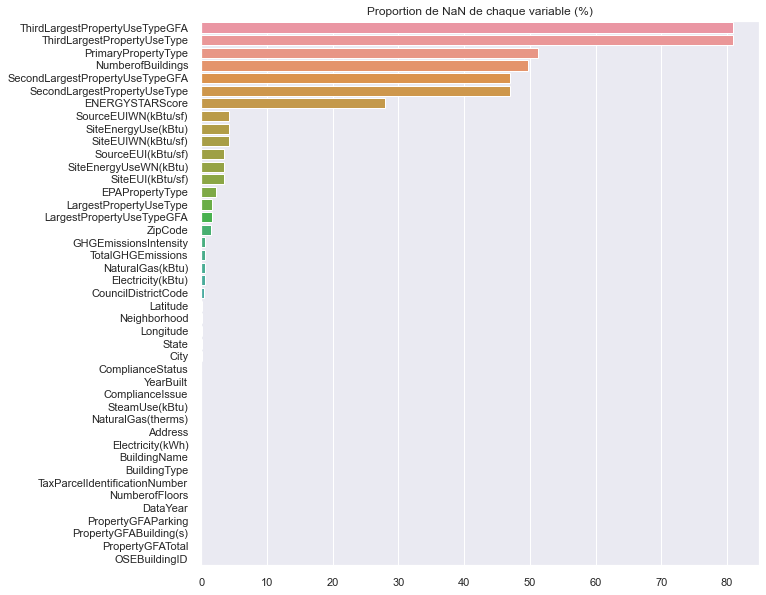

In [1017]:
# Check the proportion of NaN value for each column 
plt.figure(figsize=(10,10))
plt.title('Proportion de NaN de chaque variable (%)')
NaNValues=MergedData.isnull().sum().sort_values(ascending=False)
sns.barplot(x=NaNValues.values/MergedData.shape[0]*100, y=NaNValues.index)

<p>Nous constatons que les variables pour lesquelles on a plus de de NaN values sont les deuxième et troisième utilisations les plus importantes d'une propriété (par exemple, un bureau, un magasin de détail) en termes de GFA ainsi que le Score ENERGYSTARS. La proportitions des NaN dépassent les <strong>25%</strong> pour les premiers et les <strong>45%</strong> pour les premiers.</p>

<p>Dans la suite, les variables dont le taux de NaN est élevé à 45% seront supprimées puisque une imputation aura des effets (répercussion) sur notre modèle. Il s'agit des variables :
    <ul>
        <li>'ThirdLargestPropertyUseType' ;</li>
        <li>'ThirdLargestPropertyUseTypeGFA' ;</li>            
        <li>'SecondLargestPropertyUseTypeGFA' ;</li>   
        <li>'SecondLargestPropertyUseType' ;</li>
        <li>'PrimaryPropertyType' ;</li>
        <li>'NumberofBuildings'</li>
    </ul>
</p>

In [1018]:
MergedData.shape

(7209, 43)

In [9]:
## Création de la fonction qui permet de supprimer toutes les variables qui ont des NaN values à plus de 45%
def DropNaNSup45(Data):
    x=Data.isnull().sum().sort_values(ascending=False)*100/Data.shape[0]
    x=x[x>45]
    Data.drop(Data.iloc[:,Data.columns.isin(x[x>45].index)==True].columns,axis=1,inplace=True)
    return Data

In [10]:
MergedData=DropNaNSup45(MergedData)

In [11]:
MergedData.shape

(7209, 37)

In [1022]:
MergedData.columns

Index(['OSEBuildingID', 'DataYear', 'BuildingName', 'BuildingType',
       'TaxParcelIdentificationNumber', 'Address', 'City', 'State', 'ZipCode',
       'Latitude', 'Longitude', 'Neighborhood', 'CouncilDistrictCode',
       'YearBuilt', 'NumberofFloors', 'PropertyGFATotal',
       'PropertyGFABuilding(s)', 'PropertyGFAParking', 'ENERGYSTARScore',
       'SiteEUIWN(kBtu/sf)', 'SiteEUI(kBtu/sf)', 'SiteEnergyUse(kBtu)',
       'SiteEnergyUseWN(kBtu)', 'SourceEUIWN(kBtu/sf)', 'SourceEUI(kBtu/sf)',
       'LargestPropertyUseType', 'LargestPropertyUseTypeGFA',
       'Electricity(kWh)', 'SteamUse(kBtu)', 'NaturalGas(therms)',
       'EPAPropertyType', 'ComplianceStatus', 'ComplianceIssue',
       'Electricity(kBtu)', 'NaturalGas(kBtu)', 'TotalGHGEmissions',
       'GHGEmissionsIntensity'],
      dtype='object')

<p> Un autre constat est que certaines variables sont répétées avec des unités différentes.<br>Il s'agit notamment de:
    <ul>
        <li>'Electricity(kWh)' et 'Electricity(kBtu)' ;</li>
        <li>'NaturalGas(therms)' et 'NaturalGas(kBtu)'.</li>
    </ul> 
</p>
<p> On va supprimer l'une des variables et garder l'autre sachant que :
    <ul>
        <li><strong>1th = 100 kBtu</strong></li>
        <li><strong>1 kBTU = 0.293014534 kWh</strong></li>
    </ul>
Certaines variables de l'énergie telles que:
    <ul>
        <li>'SiteEUIWN(kBtu/sf)' et 'SiteEUI(kBtu/sf)' : exprime l'intensité réelle de la consommation d'énergie du bâtiment et celle du bâtiment normalisée par les conditions météorologiques, i.e, celle qu'il aurait consommée dans des conditions météorologiques moyennes sur 30 ans.</li>
        <li>'SiteEnergyUse(kBtu)' et 'SiteEnergyUseWN(kBtu)' : exprime l'utilisation réelle d'énergie du bâtiment et celle du bâtiment normalisée par les conditions météorologiques, i.e, celle qu'il aurait utilisée dans des conditions météorologiques moyennes sur 30 ans.</li>
        <li>'SourceEUIWN(kBtu/sf)' et 'SourceEUI(kBtu/sf)' : exprime l'énergie source réelle du bâtiment et celle du bâtiment normalisée par les conditions météorologiques, i.e, celle qu'il aurait utilisée dans des conditions météorologiques moyennes sur 30 ans.</li>
    </ul>
Nous en profiterons également pour supprimer les variables non unile pour la suite.
Il s'agit des variables suivantes:
    <ul>
        <li>'BuildingName' ;</li>
        <li>'Address' ;</li>            
        <li>'City' ;</li>   
        <li>'State' ;</li>
        <li>'ZipCode' ;</li>
        <li>'CouncilDistrictCode' ;</li>
    </ul>

<u><strong>NB</strong></u> : La description de toutes les variables est faites sur le fichier Excel "<a href="#" target="_blank"><span style="color:green;"><strong>features_chosen.xlsx</strong></span>"</a>

<p style="font-size:18px;"><strong>Suppression des variables répététives et celles qui ne seront pas utilisées dans la suite</strong></p>

In [12]:
BuildingName=MergedData['BuildingName'] ## On en aura besoin dans la suite
MergedData.drop(
    [
    'Electricity(kWh)','NaturalGas(therms)', ## les variables répététives
    'BuildingName',
    'Address',
    'City',
    'State',
    'ZipCode',
    'CouncilDistrictCode'
        ],
    axis=1, inplace=True)

In [13]:
## Voir les modalités de chaque variable catégorielle
def categorial_variables_modalities(Data):
    categorial_variables=Data.select_dtypes(exclude=[np.number])
    for i in categorial_variables.columns:
        print(categorial_variables[i].value_counts())
        print("_"*75)
    ##return categorial_variables

In [14]:
categorial_variables_modalities(MergedData)

NonResidential          2967
Multifamily LR (1-4)    2139
Multifamily MR (5-9)    1419
Multifamily HR (10+)     257
SPS-District K-12        198
Nonresidential COS       133
Campus                    92
Nonresidential WA          4
Name: BuildingType, dtype: int64
___________________________________________________________________________
1625049001    50
0925049346    12
0002400002    10
3224049012    10
7666203240     8
              ..
7821200700     1
1988200090     1
9528102740     1
9468200032     1
2926049224     1
Name: TaxParcelIdentificationNumber, Length: 3553, dtype: int64
___________________________________________________________________________
DOWNTOWN                                                 1214
EAST                                                      971
MAGNOLIA / QUEEN ANNE                                     903
GREATER DUWAMISH                                          741
NORTHEAST                                                 645
LAKE UNION            

#### Essayons de visualiser l'évolution de certaines variables au cours des années.

<p> Les émissions de CO2 </p>

In [15]:
MergedData.TotalGHGEmissions.agg(['max','min'])

max    310839.6
min         0.0
Name: TotalGHGEmissions, dtype: float64

(0.0, 500.0)

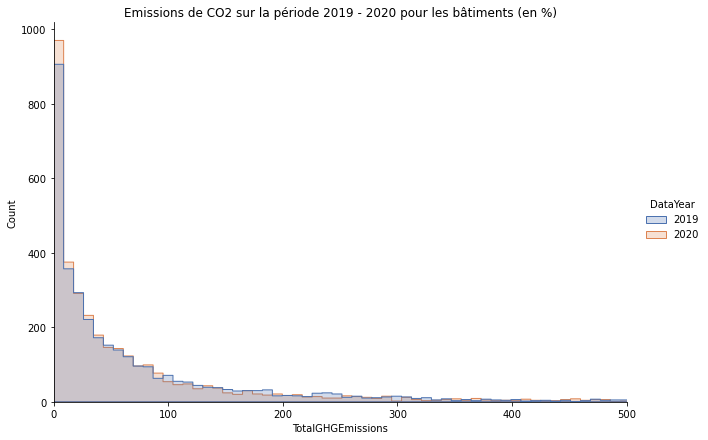

In [16]:
Data2Plot = MergedData[['OSEBuildingID','DataYear','TotalGHGEmissions']].groupby("OSEBuildingID").filter(lambda x: len(x) > 1).sort_values(by='OSEBuildingID')
ThePlot = sns.displot(Data2Plot, x='TotalGHGEmissions', hue='DataYear',element="step", palette='deep', height=6, aspect=1.5)
ThePlot.set(title="Emissions de CO2 sur la période 2019 - 2020 pour les bâtiments (en %)")
plt.xlim(0,500)

<p>On constate une légère évolution des émissions de CO2 par les bâtiments durant la période 2019 - 2020.</p>

<p> La consommation d'énergie des bâtiments</p>

In [864]:
MergedData['SiteEnergyUse(kBtu)'].agg(['max','min'])

max    6.063691e+09
min    0.000000e+00
Name: SiteEnergyUse(kBtu), dtype: float64

(0.0, 30000000.0)

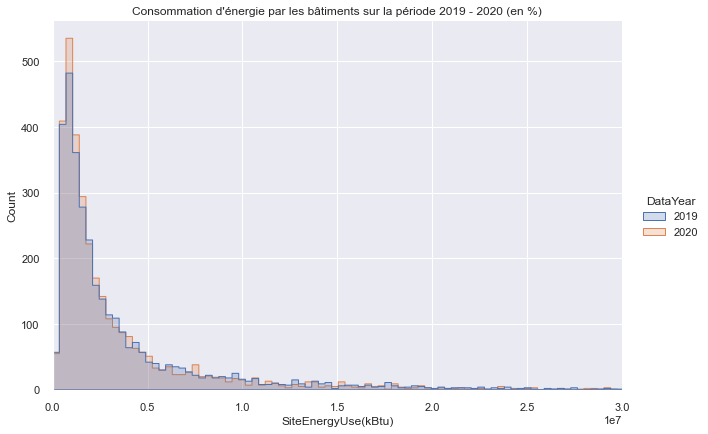

In [1028]:
Data2Plot = MergedData[['OSEBuildingID','DataYear','SiteEnergyUse(kBtu)']].groupby("OSEBuildingID").filter(lambda x: len(x) > 1).sort_values(by='OSEBuildingID')
ThePlot = sns.displot(Data2Plot, x='SiteEnergyUse(kBtu)', hue='DataYear',element="step", palette='deep', height=6, aspect=1.5)
ThePlot.set(title="Consommation d'énergie par les bâtiments sur la période 2019 - 2020 (en %)")
plt.xlim(0,0.3e8)

<p> Cette visualisation permet de voir, comme pour les émissions de CO2, une légère évolution de la consommation d'énergie par les bâtiments durant la période 2019 - 2020.</p>

#### Voir une description des variables numériques

In [17]:
## Voir les propriétés des variables numériques pour repérer les éventuelles incorrections
MergedData.select_dtypes(exclude=[np.object_]).describe()

,OSEBuildingID,DataYear,Latitude,Longitude,YearBuilt,NumberofFloors,PropertyGFATotal,PropertyGFABuilding(s),PropertyGFAParking,ENERGYSTARScore,...,SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SourceEUIWN(kBtu/sf),SourceEUI(kBtu/sf),LargestPropertyUseTypeGFA,SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity
count,7209.000000,7209.000000,7205.000000,7205.000000,7209.000000,7209.000000,7.209000e+03,7.209000e+03,7209.000000,5193.000000,...,6.904000e+03,6.963000e+03,6904.000000,6963.000000,7.093000e+03,7.209000e+03,7.174000e+03,7.174000e+03,7174.000000,7174.000000
mean,23319.063254,2019.503260,47.624735,-122.334795,1972.199750,4.990706,1.058756e+05,9.029206e+04,15583.517825,73.116696,...,6.139201e+06,6.076237e+06,118.117280,117.094097,8.580018e+04,1.124141e+06,3.358224e+06,1.427135e+06,159.610636,1.290549
std,13919.184833,0.500024,0.046965,0.027054,34.337899,5.653989,2.331222e+05,2.111133e+05,46244.445727,24.797047,...,7.470348e+07,7.198807e+07,290.525338,281.688955,2.476245e+05,6.896455e+07,9.343967e+06,7.426007e+06,3705.643839,11.097917
min,1.000000,2019.000000,47.499170,-122.414250,1896.000000,0.000000,2.000000e+04,9.660000e+03,-3.000000,1.000000,...,0.000000e+00,0.000000e+00,0.000000,0.000000,5.100000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,20228.000000,2019.000000,47.601140,-122.350550,1952.000000,3.000000,2.939400e+04,2.749800e+04,0.000000,60.000000,...,9.604658e+05,9.472790e+05,67.600000,66.700000,2.591400e+04,0.000000e+00,6.140072e+05,0.000000e+00,7.700000,0.200000
50%,23516.000000,2020.000000,47.619270,-122.332410,1979.000000,4.000000,4.687300e+04,4.364500e+04,0.000000,80.000000,...,1.862802e+06,1.842312e+06,85.400000,84.300000,4.170600e+04,0.000000e+00,1.145100e+06,3.376005e+05,32.100000,0.600000
75%,26741.000000,2020.000000,47.657130,-122.318770,2001.000000,6.000000,9.993100e+04,8.844900e+04,8656.000000,93.000000,...,4.294009e+06,4.263687e+06,119.700000,118.950000,8.209800e+04,0.000000e+00,2.711336e+06,1.269681e+06,90.300000,1.400000
max,50697.000000,2020.000000,47.733870,-122.258640,2019.000000,76.000000,9.320156e+06,9.320156e+06,686750.000000,100.000000,...,6.063691e+09,5.859773e+09,21839.400000,21107.600000,1.521647e+07,5.845455e+09,2.705582e+08,3.880064e+08,310839.600000,927.700000


<p>On constate qu'il y a des bâtiments pour lesquelles l'Espace total en pieds carrés de tous les types de stationnement (PropertyGFAParking) est négatif. Pour d'autres bâtiments, la consommation d'énergie, l'énergie source, l'électricité, les émissions de CO2... ne sont pas renseignés.</p>
<p>Enumérons ces erreurs</p>

In [18]:
## PropertyGFAParking négatif
MergedData[MergedData.PropertyGFAParking<0]

,OSEBuildingID,DataYear,BuildingType,TaxParcelIdentificationNumber,Latitude,Longitude,Neighborhood,YearBuilt,NumberofFloors,PropertyGFATotal,...,LargestPropertyUseType,LargestPropertyUseTypeGFA,SteamUse(kBtu),EPAPropertyType,ComplianceStatus,ComplianceIssue,Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity
3272,49970,2019,NonResidential,1625049001,47.65718,-122.31632,NORTHEAST,2011,0,176225,...,Residence Hall/Dormitory,176225.0,0,Residence Hall/Dormitory,Compliant,No Issue,3530243.0,1714995.0,112.8,0.6
3243,49970,2020,NonResidential,1625049001,47.65718,-122.31632,NORTHEAST,2011,0,176225,...,Residence Hall/Dormitory,176225.0,0,Residence Hall/Dormitory,Compliant,No Issue,3147652.0,1421892.0,92.3,0.5


<p>
    Il s'agit donc du bâtiment d'identifiant <strong>49970</strong>.
</p>

In [1031]:
## Bâtiments pour lesquels l'énergie source est nulle
MergedData[MergedData['SourceEUI(kBtu/sf)']<=0]


,OSEBuildingID,DataYear,BuildingType,TaxParcelIdentificationNumber,Latitude,Longitude,Neighborhood,YearBuilt,NumberofFloors,PropertyGFATotal,...,LargestPropertyUseType,LargestPropertyUseTypeGFA,SteamUse(kBtu),EPAPropertyType,ComplianceStatus,ComplianceIssue,Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity
785,19876,2019,NonResidential,0656000215,47.61543,-122.34651,DOWNTOWN,1954,2,28696,...,Other,12960.0,0,Mixed Use Property,Not Compliant,Missing 2019 EUI or Electricity Data,0.0,0.0,0.0,0.0


<p>Il s'agit du bâtiment d'identifiant <strong>19876</strong> en <strong>2019</strong></p>

### Revenons aux valeurs manquantes

<p>Il s'agira de trouver une méthode d'imputation de ces valeurs manquantes.</p>
<p>Dans le cadre de notre travail, il s'agira de faire une imputation par catégorie de variables :
<ul>
    <li> Pour les variables numériques, nous procéderons à une imputation par la méthode de KNN imputer</li>;
    <li> Par rapport aux variables catégorielles, nous utiliserons le <strong>mode</strong> pour faire l'imputation des valeurs manquantes des variables à moins de 5% de pourcentage. Et pour le reste, nous utiliserons le KNN imputer too.</li>
</ul>
</p>
<p>
    <strong>Pourquoi le KNN Imputer ?</strong><br>
L'idée des méthodes kNN est d'identifier "k" échantillons dans l'ensemble de données qui sont similaires ou proches dans l'espace. Ensuite, nous utilisons ces échantillons "k" pour estimer la valeur des points de données manquants. Les valeurs manquantes de chaque échantillon sont imputées en utilisant la valeur moyenne des 'k'-voisins trouvés dans l'ensemble de données.(Source: <a href="https://www.analyticsvidhya.com/blog/2020/07/knnimputer-a-robust-way-to-impute-missing-values-using-scikit-learn/#:~:text=The%20idea%20in%20kNN%20methods,neighbors%20found%20in%20the%20dataset." target="_blank">Cliquer ici pour plus d'information</a>).<br>
</p>

<p>
    <strong>Pourquoi le mode ?</strong><br>
L'imputation par mode consiste à remplacer toutes les occurrences de NaN values NaN au sein d'une variable par le mode, qui en d'autres termes désigne la valeur la plus fréquente ou la catégorie la plus fréquente.<br>C'est une méthode facile à mettre en œuvre et c'est le moyen le plus rapide d'obtenir des jeux de données complets. Elle est utilisé, dans la plupart des cas, quand pas plus de <strong>5%</strong> de la variable contient des données manquantes car présentant les limites suivantes:
    <ul>
        <li>Il déforme la relation entre l'étiquette la plus fréquente et les autres variables de l'ensemble de données </li>
        <li>Elle peut conduire à une surreprésentation de l'étiquette la plus fréquente s'il y a un grand nombre de NA</li>
    </ul>
    Pour plus d'information : <a href="https://medium.com/geekculture/frequent-category-imputation-missing-data-imputation-technique-4d7e2b33daf7" target="_blank">Cliquer ici</a>
</p>

In [19]:
## Imputation des variables numériques
num=[col for col in MergedData.columns if MergedData[col].dtypes!='O']
categorial=[col for col in MergedData.columns if MergedData[col].dtypes=='O']

##### Les variables numériques

In [20]:
MergedData[num]

,OSEBuildingID,DataYear,Latitude,Longitude,YearBuilt,NumberofFloors,PropertyGFATotal,PropertyGFABuilding(s),PropertyGFAParking,ENERGYSTARScore,...,SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SourceEUIWN(kBtu/sf),SourceEUI(kBtu/sf),LargestPropertyUseTypeGFA,SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity
0,1,2019,47.61220,-122.33799,1927,12,88434,88434,0,62.0,...,7363218.0,7351864.0,167.6,167.6,88434.0,2159078,3871996.0,1320791.0,208.8,2.4
1,2,2019,47.61317,-122.33393,1996,11,103566,88502,15064,70.0,...,8040648.0,8006404.0,153.7,153.3,83880.0,0,2946902.0,5059502.0,286.9,3.2
2,3,2019,47.61367,-122.33822,1969,41,956110,759392,196718,64.0,...,68355568.0,68103264.0,201.5,201.1,756493.0,22601024,44075841.0,1426400.0,1549.0,2.0
3,5,2019,47.61412,-122.33664,1926,10,61320,61320,0,58.0,...,6346838.0,6319004.0,177.5,176.3,61320.0,2104444,2201145.0,2013415.0,232.4,3.8
4,8,2019,47.61375,-122.34047,1980,18,175580,113580,62000,63.0,...,15875107.0,15875107.0,212.2,212.2,123445.0,0,5444815.0,10430292.0,587.5,5.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3623,50690,2020,47.69996,-122.34505,2019,6,213065,213065,0,NaN,...,NaN,NaN,NaN,NaN,226973.0,0,NaN,NaN,NaN,NaN
3624,50692,2020,47.61875,-122.35523,2018,7,182411,138533,43878,NaN,...,3250235.0,3211659.0,71.2,70.9,113351.0,0,2796535.0,415123.0,36.9,0.3
3625,50693,2020,47.65019,-122.36173,1960,3,20289,20289,0,NaN,...,2211138.0,2111309.0,195.2,188.1,18289.0,0,914426.0,1196883.0,68.4,3.4
3626,50694,2020,47.61598,-122.30770,2002,7,183379,136682,46697,74.0,...,6643564.0,6543062.0,86.0,85.3,105997.0,0,2733787.0,3809275.0,216.8,1.6


##### Les variables catégorielles

In [21]:
MergedData[categorial]

,BuildingType,TaxParcelIdentificationNumber,Neighborhood,LargestPropertyUseType,EPAPropertyType,ComplianceStatus,ComplianceIssue
0,NonResidential,0659000030,DOWNTOWN,Hotel,Hotel,Compliant,No Issue
1,NonResidential,0659000220,DOWNTOWN,Hotel,Hotel,Compliant,No Issue
2,NonResidential,0659000475,DOWNTOWN,Hotel,Hotel,Compliant,No Issue
3,NonResidential,0659000640,DOWNTOWN,Hotel,Hotel,Compliant,No Issue
4,NonResidential,0659000970,DOWNTOWN,Hotel,Hotel,Compliant,No Issue
...,...,...,...,...,...,...,...
3623,NonResidential,0306000570,NORTHWEST,Self-Storage Facility,Self-Storage Facility,Compliant,No Issue
3624,Multifamily MR (5-9),1989201430,MAGNOLIA / QUEEN ANNE,Multifamily Housing,Multifamily MR (5-9),Compliant,No Issue
3625,NonResidential,0000000000,MAGNOLIA / QUEEN ANNE,College/University,College/University,Compliant,No Issue
3626,Multifamily MR (5-9),7234601325,CENTRAL,Multifamily Housing,Multifamily MR (5-9),Compliant,No Issue


### Imputation des valeurs numériques par la méthode KNNImputer

In [22]:
## Définition de la fonction knn
knn=KNNImputer(n_neighbors=5 ##,add_indicator=True
              )
               ## add_indicator pour dire donner une indication que la ligne 
                ## contienait bien une valeur manquante

In [23]:
knn.fit(MergedData[num])

KNNImputer()

In [24]:
pd.DataFrame(knn.transform(MergedData[num]))

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,1.0,2019.0,47.61220,-122.33799,1927.0,12.0,88434.0,88434.0,0.0,62.0,...,7363218.0,7351864.0,167.6,167.60,88434.0,2159078.0,3871996.0,1320791.0,208.80,2.40
1,2.0,2019.0,47.61317,-122.33393,1996.0,11.0,103566.0,88502.0,15064.0,70.0,...,8040648.0,8006404.0,153.7,153.30,83880.0,0.0,2946902.0,5059502.0,286.90,3.20
2,3.0,2019.0,47.61367,-122.33822,1969.0,41.0,956110.0,759392.0,196718.0,64.0,...,68355568.0,68103264.0,201.5,201.10,756493.0,22601024.0,44075841.0,1426400.0,1549.00,2.00
3,5.0,2019.0,47.61412,-122.33664,1926.0,10.0,61320.0,61320.0,0.0,58.0,...,6346838.0,6319004.0,177.5,176.30,61320.0,2104444.0,2201145.0,2013415.0,232.40,3.80
4,8.0,2019.0,47.61375,-122.34047,1980.0,18.0,175580.0,113580.0,62000.0,63.0,...,15875107.0,15875107.0,212.2,212.20,123445.0,0.0,5444815.0,10430292.0,587.50,5.20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7204,50690.0,2020.0,47.69996,-122.34505,2019.0,6.0,213065.0,213065.0,0.0,84.0,...,15201665.6,15321573.6,159.4,160.34,226973.0,0.0,10069218.6,940887.4,107.48,0.52
7205,50692.0,2020.0,47.61875,-122.35523,2018.0,7.0,182411.0,138533.0,43878.0,67.2,...,3250235.0,3211659.0,71.2,70.90,113351.0,0.0,2796535.0,415123.0,36.90,0.30
7206,50693.0,2020.0,47.65019,-122.36173,1960.0,3.0,20289.0,20289.0,0.0,50.4,...,2211138.0,2111309.0,195.2,188.10,18289.0,0.0,914426.0,1196883.0,68.40,3.40
7207,50694.0,2020.0,47.61598,-122.30770,2002.0,7.0,183379.0,136682.0,46697.0,74.0,...,6643564.0,6543062.0,86.0,85.30,105997.0,0.0,2733787.0,3809275.0,216.80,1.60


In [25]:
NumImputed=pd.DataFrame(knn.transform(MergedData[num]))

In [26]:
NumImputed.columns=num

In [27]:
NumImputed.index=MergedData.index

In [28]:
NumImputed.isnull().sum()

OSEBuildingID                0
DataYear                     0
Latitude                     0
Longitude                    0
YearBuilt                    0
NumberofFloors               0
PropertyGFATotal             0
PropertyGFABuilding(s)       0
PropertyGFAParking           0
ENERGYSTARScore              0
SiteEUIWN(kBtu/sf)           0
SiteEUI(kBtu/sf)             0
SiteEnergyUse(kBtu)          0
SiteEnergyUseWN(kBtu)        0
SourceEUIWN(kBtu/sf)         0
SourceEUI(kBtu/sf)           0
LargestPropertyUseTypeGFA    0
SteamUse(kBtu)               0
Electricity(kBtu)            0
NaturalGas(kBtu)             0
TotalGHGEmissions            0
GHGEmissionsIntensity        0
dtype: int64

<p style="font-size:20px"><strong>Imputation des valeurs manquantes des variables catégorielles par le mode pour les variables à pourcentage de NaN inférieures à 5% et par la méthode du KNNImputer pour les autres</strong></p>

In [29]:
x=MergedData[categorial].isnull().sum().sort_values(ascending=False)*100/MergedData.shape[0]
x<5

EPAPropertyType                  True
LargestPropertyUseType           True
Neighborhood                     True
BuildingType                     True
TaxParcelIdentificationNumber    True
ComplianceStatus                 True
ComplianceIssue                  True
dtype: bool

<p>Apparemment toutes les variables catégorielles sont à pourcentage de NaN inférieure à <strong>5%</strong>. C'est d'ailleurs ce qui va nous permettre d'imputer par le <strong>mode</strong>.</p>

In [30]:
## Imputation colonne par colonne
def ImputationByMode(Data):
    for i in Data.columns:
        Data[i].fillna(Data[i].mode()[0],inplace=True)
    return Data

In [31]:
## Test
CategorialData=MergedData[categorial]

In [32]:
CategorialData=ImputationByMode(CategorialData)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\series.py:4463: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


In [33]:
CategorialData.isnull().sum()

BuildingType                     0
TaxParcelIdentificationNumber    0
Neighborhood                     0
LargestPropertyUseType           0
EPAPropertyType                  0
ComplianceStatus                 0
ComplianceIssue                  0
dtype: int64

#### L'imputation est faite pour les deux catégories de variables

## Analyse descriptive

#### Visualisation des bâtiments

In [42]:

##import streamlit as st
import folium
from folium import plugins


##st.title("Test")
#m = folium.Map([38.8934, -76.9470], tiles="stamentoner", zoom_start=12)
#m.save("map test.html", close_file=True)
##st.markdown(m._repr_html_(), unsafe_allow_html=True)

In [40]:
data_map = folium.Map(location=MergedData[['Latitude','Longitude']].mean().tolist(), zoom_start=12)

In [44]:
marker_cluster = plugins.MarkerCluster().add_to(data_map)

# Add markers to the marker cluster for each data point
for row in range(MergedData.shape[0]):
    folium.Marker(
        location=list(NumImputed[['Latitude','Longitude']].iloc[row].values),
        popup=BuildingName.iloc[row],  # Popup text is in a column of the dataframe
    ).add_to(marker_cluster)
##st.markdown(data_map._repr_html_(), unsafe_allow_html=True)
# Display the map
data_map

### Pour les variables numériques

In [45]:
NumImputed.columns

Index(['OSEBuildingID', 'DataYear', 'Latitude', 'Longitude', 'YearBuilt',
       'NumberofFloors', 'PropertyGFATotal', 'PropertyGFABuilding(s)',
       'PropertyGFAParking', 'ENERGYSTARScore', 'SiteEUIWN(kBtu/sf)',
       'SiteEUI(kBtu/sf)', 'SiteEnergyUse(kBtu)', 'SiteEnergyUseWN(kBtu)',
       'SourceEUIWN(kBtu/sf)', 'SourceEUI(kBtu/sf)',
       'LargestPropertyUseTypeGFA', 'SteamUse(kBtu)', 'Electricity(kBtu)',
       'NaturalGas(kBtu)', 'TotalGHGEmissions', 'GHGEmissionsIntensity'],
      dtype='object')

<p>Nous ferons l'analyse descriptive des variables suivantes:</p>
<ul>
    <li>'ENERGYSTARScore',</li>
    <li>'SiteEUI(kBtu/sf)' et 'SiteEUIWN(kBtu/sf)',</li>
    <li>'SiteEnergyUse(kBtu)' et 'SiteEnergyUseWN(kBtu)',</li>
    <li>'SourceEUI(kBtu/sf)' et 'SourceEUIWN(kBtu/sf)',</li>
    <li>'SteamUse(kBtu)',</li>
    <li>'Electricity(kBtu)',</li>
    <li>'NaturalGas(kBtu)',</li>
    <li>'TotalGHGEmissions',</li>
    <li>'GHGEmissionsIntensity'</li>
</ul>

In [1053]:
col=[
'ENERGYSTARScore',
'SteamUse(kBtu)',
'Electricity(kBtu)',
'NaturalGas(kBtu)',
'TotalGHGEmissions',
'GHGEmissionsIntensity'
]

##'SourceEUI(kBtu/sf)','SourceEUIWN(kBtu/sf)',

##### Distribution des intensités d'énergies (réelle consommée et celle normalisée par les conditions météorologiques

(0.0, 400.0)

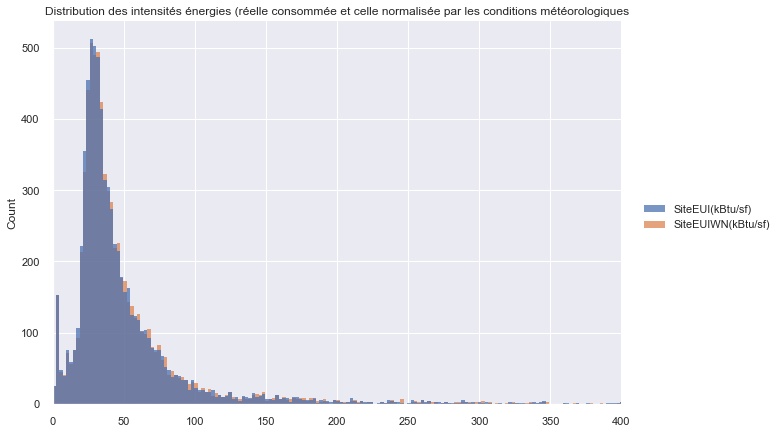

In [1054]:
ThePlot = sns.displot(NumImputed[['SiteEUI(kBtu/sf)','SiteEUIWN(kBtu/sf)']],  palette='deep', height=6, aspect=1.5)
ThePlot.set(title="Distribution des intensités énergies (réelle consommée et celle normalisée par les conditions météorologiques")
plt.xlim(0,400)

<p>A travers ce graphique, on soupçonne une corrélation significative entre ces deux features.</p>

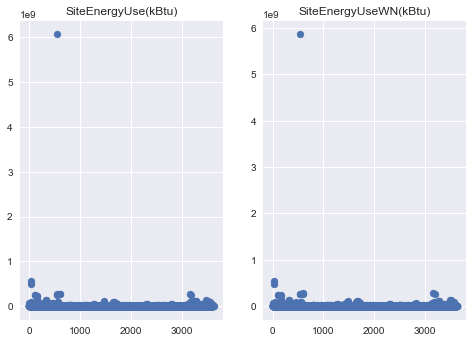

In [1056]:
from matplotlib import rcParams
plt.subplot(1,2,1)
plt.title('SiteEnergyUse(kBtu)')
plt.style.use('seaborn')
plt.scatter(MergedData.index, MergedData['SiteEnergyUse(kBtu)'])
plt.subplot(1,2,2)
plt.title('SiteEnergyUseWN(kBtu)')
plt.style.use('seaborn')
plt.scatter(MergedData.index, MergedData['SiteEnergyUseWN(kBtu)'])

<p>Nous soupçonnons à travers ces figures des valeurs abérentes pour les deux variables. Mais, nous pouvons également soupçons une corrélation significative entre ces deux variables. </p>

#### BoxPlot des variables numériques

In [1057]:
def NumVarBoxPlot(Data):
    for columns in Data.columns:
        plt.figure(figsize = (8,1))
        sns.boxplot(x = Data[columns])
        titre = 'Répartition de : '+ columns
        plt.title(titre)
        plt.xlabel(columns)
        plt.show()
    sns.set(font_scale = 1)

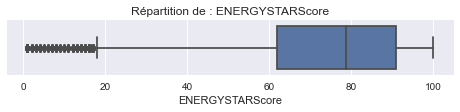

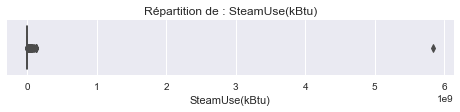

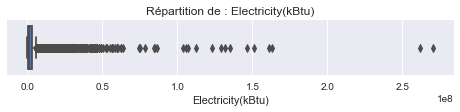

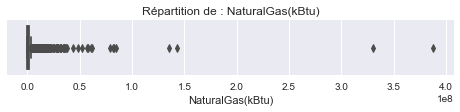

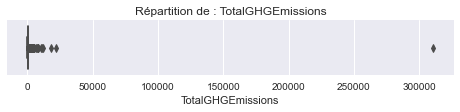

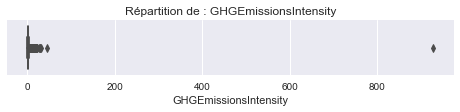

In [1058]:
NumVarBoxPlot(NumImputed[col])

#### Les variables catégorielles

In [1059]:
CategorialData.columns

Index(['BuildingType', 'TaxParcelIdentificationNumber', 'Neighborhood',
       'LargestPropertyUseType', 'EPAPropertyType', 'ComplianceStatus',
       'ComplianceIssue'],
      dtype='object')

In [1060]:
categorial_variables_modalities(MergedData)

NonResidential          2967
Multifamily LR (1-4)    2139
Multifamily MR (5-9)    1419
Multifamily HR (10+)     257
SPS-District K-12        198
Nonresidential COS       133
Campus                    92
Nonresidential WA          4
Name: BuildingType, dtype: int64
___________________________________________________________________________
1625049001    50
0925049346    12
0002400002    10
3224049012    10
3624039009     8
              ..
7666202475     1
3881900170     1
5260300283     1
2926049224     1
2768303315     1
Name: TaxParcelIdentificationNumber, Length: 3553, dtype: int64
___________________________________________________________________________
DOWNTOWN                                                 1214
EAST                                                      971
MAGNOLIA / QUEEN ANNE                                     903
GREATER DUWAMISH                                          741
NORTHEAST                                                 645
LAKE UNION            

<p>Dans la suite, nous ferons le recodage de certaines variables qui ont beaucoup de modalités</p>

## Recodage des variables catégorielles

In [1065]:
CategorialData["BuildingType"].replace(['Multifamily LR (1-4)','Multifamily MR (5-9)','Multifamily HR (10+)'],"Multifamily",inplace=True)
CategorialData["BuildingType"].replace(['Nonresidential WA','Nonresidential COS'],"NonResidential",inplace=True)
CategorialData["EPAPropertyType"].replace(['Multifamily LR (1-4)','Multifamily MR (5-9)','Multifamily HR (10+)'],"Multifamily",inplace=True)

In [1066]:
##Recodage des variables
def recodage(Data):
    for i in Data.columns:
        if i!="BuildingType":
            for j in list(Data[i].unique()):
                if Data[i][Data[i]==j].value_counts()[0]<100:
                    ##Data[Data[i]==j][i].replace(j,"Autres",inplace=True)
                    Data[i].replace(j,"Autres_"+i,inplace=True)
    return Data

In [1067]:
CategorialData=recodage(CategorialData)

In [1068]:
categorial_variables_modalities(CategorialData)

Multifamily          3815
NonResidential       3104
SPS-District K-12     198
Campus                 92
Name: BuildingType, dtype: int64
___________________________________________________________________________
Autres_TaxParcelIdentificationNumber    7209
Name: TaxParcelIdentificationNumber, dtype: int64
___________________________________________________________________________
DOWNTOWN                  1218
EAST                       971
MAGNOLIA / QUEEN ANNE      903
GREATER DUWAMISH           741
NORTHEAST                  645
LAKE UNION                 557
NORTHWEST                  441
SOUTHWEST                  355
NORTH                      302
BALLARD                    281
CENTRAL                    221
SOUTHEAST                  205
Autres_Neighborhood        202
DELRIDGE NEIGHBORHOODS     167
Name: Neighborhood, dtype: int64
___________________________________________________________________________
Multifamily Housing              3798
Autres_LargestPropertyUseType    10

<p>La variable EPAPropertyType représente les sous-types de propriété des bâtiments. Pendant que la variables LargestPropertyUseType renseigne sur le type de propriété du bâtiment en tant que tel. En plus, les mêmes modalités des deux variables ont quasiment les même effectifs. Ains, nous supprimerons la variable EPAPropertyType.</p>

In [1069]:
CategorialData.drop('EPAPropertyType',axis=1,inplace=True)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


### Corrélation des variables

<p>Les target features (les variables cibles) sont "TotalGHGEmissions" et "SiteEnergyUse(kBtu)". Nous allons les isolées de notre jeux de données en les attribuant à la variable "target"</p>

In [1070]:
target = NumImputed[["TotalGHGEmissions", "SiteEnergyUse(kBtu)"]]
target1 = target["TotalGHGEmissions"]
target2 = target["SiteEnergyUse(kBtu)"]

In [1071]:
NumImputed.drop(target, axis = 1, inplace = True)

<p> Corrélations entre les variables numérique et la variable cible numéro 1 nommée target1 </p>

In [1072]:
NumImputed["target1"] = target["TotalGHGEmissions"]  
correlation1 = NumImputed.corr()["target1"].sort_values()
correlation1

ENERGYSTARScore             -0.050205
OSEBuildingID               -0.027413
DataYear                    -0.013013
YearBuilt                   -0.011852
Latitude                    -0.006922
Longitude                    0.005341
PropertyGFAParking           0.030570
NumberofFloors               0.046239
LargestPropertyUseTypeGFA    0.049628
PropertyGFATotal             0.070137
PropertyGFABuilding(s)       0.070753
Electricity(kBtu)            0.105850
NaturalGas(kBtu)             0.111517
SourceEUI(kBtu/sf)           0.898020
SourceEUIWN(kBtu/sf)         0.903892
SiteEUI(kBtu/sf)             0.967285
SiteEUIWN(kBtu/sf)           0.968952
GHGEmissionsIntensity        0.985428
SteamUse(kBtu)               0.993153
SiteEnergyUseWN(kBtu)        0.993531
target1                      1.000000
Name: target1, dtype: float64

<p> Au seui de 1% , les variables suivantes sont trop faiblement correlées à la variable cible numéro 1 : "TotalGHGEmissions" </p>

In [1073]:
for i in correlation1.index:
    if abs(correlation1[i])<0.01:
        print(i)

Latitude
Longitude


<p> Corrélations entre les variables numériques et la variable cible numéro 2 nommée target2 </p>

In [1074]:
NumImputed["target2"] = target2  
correlation2 = NumImputed.corr()["target2"].sort_values()
correlation2

ENERGYSTARScore             -0.056903
OSEBuildingID               -0.041184
DataYear                    -0.014321
Latitude                    -0.010922
YearBuilt                   -0.000533
Longitude                    0.007773
PropertyGFAParking           0.074490
NumberofFloors               0.088639
LargestPropertyUseTypeGFA    0.094195
PropertyGFABuilding(s)       0.126127
PropertyGFATotal             0.128996
NaturalGas(kBtu)             0.156720
Electricity(kBtu)            0.209397
SourceEUI(kBtu/sf)           0.908522
SourceEUIWN(kBtu/sf)         0.913674
SiteEUI(kBtu/sf)             0.965337
SiteEUIWN(kBtu/sf)           0.966601
GHGEmissionsIntensity        0.974364
SteamUse(kBtu)               0.980676
target1                      0.994154
SiteEnergyUseWN(kBtu)        0.999979
target2                      1.000000
Name: target2, dtype: float64

<p> Au seui de 1% , les variables suivantes sont trop faiblement correlées à la variable cible numéro2 : "SiteEnergyUse(kBtu)" </p>
<p>On peut également noter une corrélation très élevée des deux targets.</p>

In [1075]:
for i in correlation2.index:
    if abs(correlation2[i])<0.01:
        print(i)

YearBuilt
Longitude


Par la suite, nous supprimerons les variables "YearBuilt" et "Longitude" car trop faiblement \
correlé avec les variables cibles

In [1076]:
### Suppression des variables très faiblement corrélées entre elles
NumImputed.drop(['Latitude','Longitude','YearBuilt'],inplace=True, axis=1)

Vérification de la relation entres features

In [1077]:
NumImputedNoTarget=NumImputed
NumImputedNoTarget.drop(["target1", "target2"], axis = 1,inplace=True)

<AxesSubplot:>

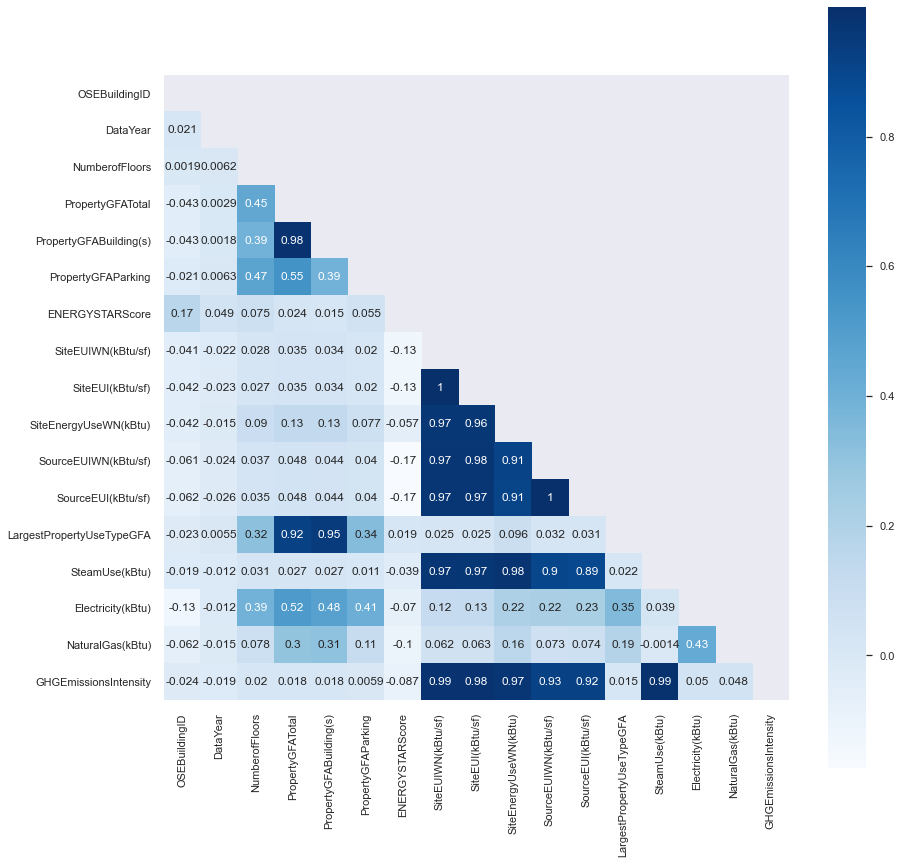

In [1078]:
plt.figure(figsize = (14,14))
mask = np.zeros_like(NumImputedNoTarget.corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(NumImputedNoTarget.corr(), cmap='Blues', annot=True, square=True, mask=mask, 
            cbar=True, vmin=None, vmax=None)

In [1079]:
correlation = NumImputed.corr()
correlation.columns.value_counts().sum().sum()

17

In [1080]:
list(correlation.columns)

['OSEBuildingID',
 'DataYear',
 'NumberofFloors',
 'PropertyGFATotal',
 'PropertyGFABuilding(s)',
 'PropertyGFAParking',
 'ENERGYSTARScore',
 'SiteEUIWN(kBtu/sf)',
 'SiteEUI(kBtu/sf)',
 'SiteEnergyUseWN(kBtu)',
 'SourceEUIWN(kBtu/sf)',
 'SourceEUI(kBtu/sf)',
 'LargestPropertyUseTypeGFA',
 'SteamUse(kBtu)',
 'Electricity(kBtu)',
 'NaturalGas(kBtu)',
 'GHGEmissionsIntensity']

In [1081]:
new_col={'OSEBuildingID' : 1, 'DataYear' : 2, 'NumberofFloors' : 3, 'PropertyGFATotal' : 4,
         'PropertyGFABuilding(s)' : 5, 'PropertyGFAParking' : 6, 'ENERGYSTARScore' : 7, 
         'SiteEUIWN(kBtu/sf)' : 8, 'SiteEUI(kBtu/sf)' : 9, 'SiteEnergyUseWN(kBtu)' : 10,
         'SourceEUIWN(kBtu/sf)' : 11, 'SourceEUI(kBtu/sf)' : 12, 
         'LargestPropertyUseTypeGFA' : 13, 'SteamUse(kBtu)' : 14, 
         'Electricity(kBtu)' : 15, 'NaturalGas(kBtu)' : 16, 'GHGEmissionsIntensity' : 17}

In [1082]:
correlation_new = correlation.rename(columns = new_col, inplace = True)

correlation_new = correlation.rename(index = new_col)
correlation_new.head(2)

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
1,1.000000,0.020757,0.001883,-0.042997,-0.042852,-0.021128,0.169106,-0.041173,-0.041768,-0.041805,-0.061353,-0.062409,-0.022702,-0.019061,-0.130862,-0.061844,-0.023955
2,0.020757,1.000000,0.006169,0.002931,0.001847,0.006344,0.048770,-0.021558,-0.023130,-0.014792,-0.024278,-0.026194,0.005519,-0.012113,-0.011869,-0.015344,-0.018905


In [1083]:
hyper_correlation = []
#T = [[]]
for i in correlation_new.columns:
    for j in range(i+1, 18):
        if abs(correlation_new.loc[i,j]) > 0.98 and i != j :
            
            T = [i , j]
            hyper_correlation.append(T)
            
        
hyper_correlation = pd.DataFrame(hyper_correlation)
#hyper_correlation.rename(columns = {0 : "ligne", 1 : "colone"})
print(hyper_correlation)
print (hyper_correlation[0].unique())
print (hyper_correlation[1].unique())
#correlation.iloc[hyper_correlation[0].unique(), :].columns

    0   1
0   4   5
1   8   9
2   8  17
3   9  17
4  11  12
5  14  17
[ 4  8  9 11 14]
[ 5  9 17 12]


Les colones récodées par les numéros [ 4  8  9 11 14] sont très corrélé aux \
aux autres variables numériques de la base. Il y a donc un problème de correlation entre les
que nous corrigérons en supprimant ces variables.

In [1084]:
to_delete1 = []
to_delete2 = []
for element in new_col.keys():
    if new_col[element] in [4,8,9,11,14]:
        to_delete1.append(element)
        
for element in new_col.keys():
    if new_col[element] in [5, 9, 17, 12]:
        to_delete2.append(element)    
print(to_delete1)
print(to_delete2)

['PropertyGFATotal', 'SiteEUIWN(kBtu/sf)', 'SiteEUI(kBtu/sf)', 'SourceEUIWN(kBtu/sf)', 'SteamUse(kBtu)']
['PropertyGFABuilding(s)', 'SiteEUI(kBtu/sf)', 'SourceEUI(kBtu/sf)', 'GHGEmissionsIntensity']


Dans la suite, nous supprimerons toutes les features de la première liste sauf 'SiteEUI(kBtu/sf)'. En effet,
**SiteEUIWN(kBtu/sf), 'SourceEUIWN(kBtu/sf)'** renseignent des énergies que le bâtiments aurait consommées dans les conditions normalisées des conditions météorologiques. Dans notre base, nous avons déjà des variables qui renseignent ces énergies réellement consommées par le bâtiment.
**PropretyGFATotal** renseigne sur la Surface brute de plancher totale du bâtiment et du parking.
**SteamUse(kBtu)** renseigne sur la quantité annuelle de vapeur de district consommée par la propriété sur place, mesurée en milliers d'unités thermiques britanniques (kBtu).

In [1085]:
### Suppression des variables trop corrélées
NumImputed.drop([
    'PropertyGFATotal',
    'SiteEUIWN(kBtu/sf)',
    'SourceEUIWN(kBtu/sf)',
    'SteamUse(kBtu)']
,inplace=True,axis=1)

In [1086]:
NumImputed.shape

(7209, 13)

### Correction des valeurs abérentes

BoxPlots pour repérer les valeurs abérentes

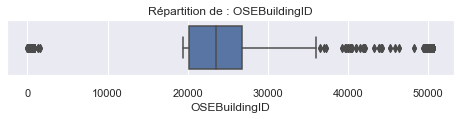

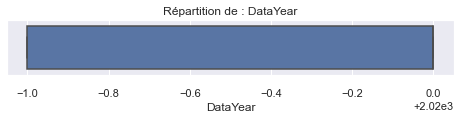

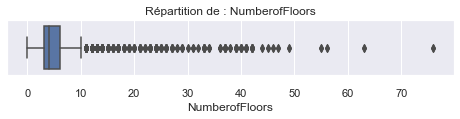

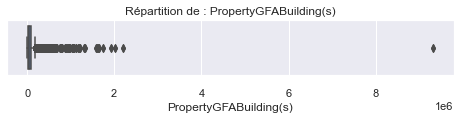

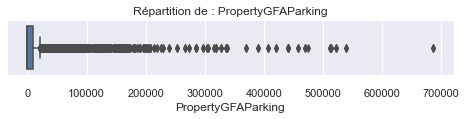

...

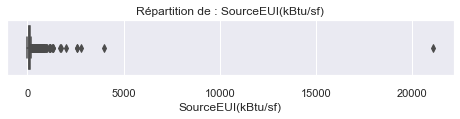

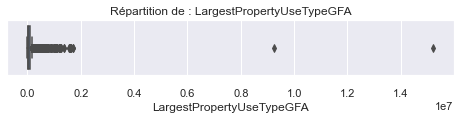

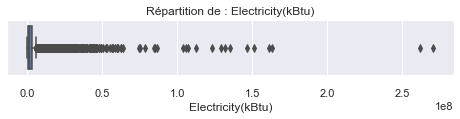

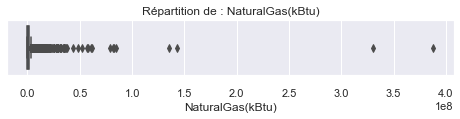

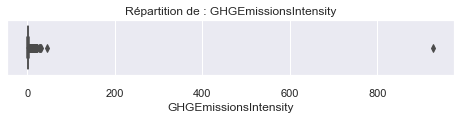

In [1087]:
NumVarBoxPlot(NumImputed)

Les boxplots ci-dessus réalisés nous montrent que plusieurs variables possèdent des valeurs abérrentes. \
Nous isolerons ces variables dans la suite

In [1088]:
def CorrectionAbValue(Data):
    for columns in NumImputed:
        if (columns !='OSEBuildingID'):
            mediane = np.median(NumImputed[columns])

            intqt = 1.5*(np.percentile(NumImputed[columns], 75) - np.percentile(NumImputed[columns], 25))
            lim_sup = intqt  + np.percentile(NumImputed[columns], 75)
            lim_inf = np.percentile(NumImputed[columns], 25) - intqt

            for ligne in NumImputed[columns]:
                if (ligne > lim_sup or ligne < lim_inf):
                    NumImputed[columns] = NumImputed[columns].replace(ligne , mediane)

In [1089]:
CorrectionAbValue(NumImputed) ## Une première correction

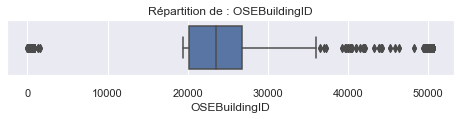

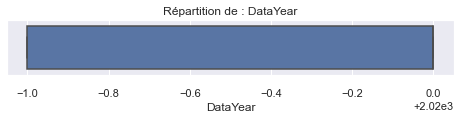

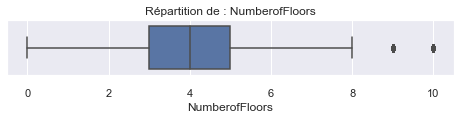

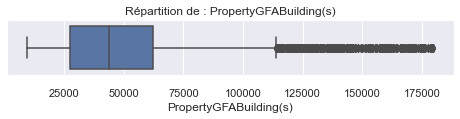

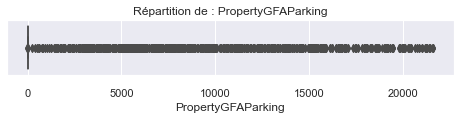

...

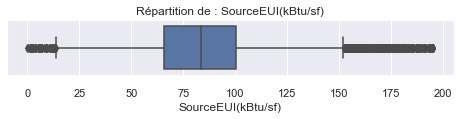

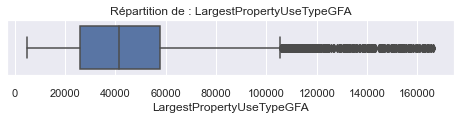

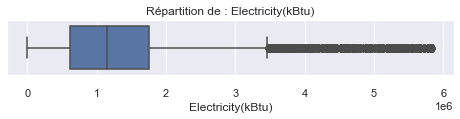

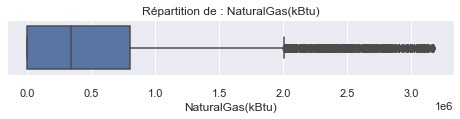

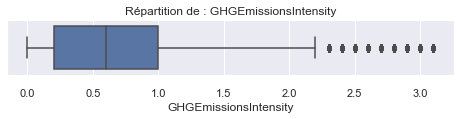

In [1090]:
NumVarBoxPlot(NumImputed)

<p>On a toujours des valeurs abérentes, d'autres corrections seront faites pour ajuster ces valeurs.<br>Pour cela, nous avons créé la fonction suivante: </p>

In [1091]:
## Fonction de répétition de la correction des valeurs abérentes
def CorrectionRepeat(Data,n):
    for i in range(n):
        CorrectionAbValue(Data)

In [1092]:
CorrectionRepeat(NumImputed,2) ## 2 nouvelles corrections

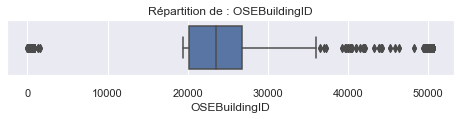

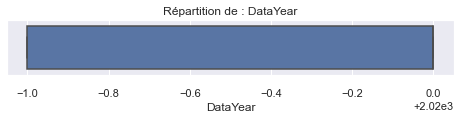

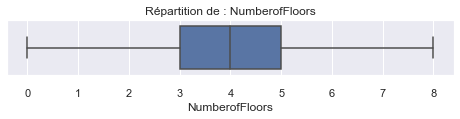

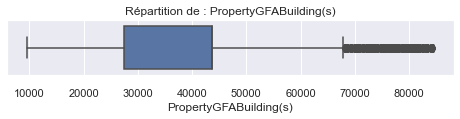

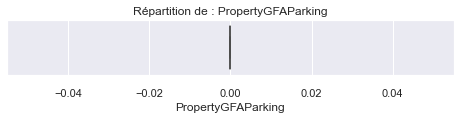

...

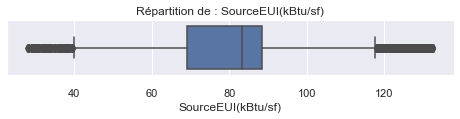

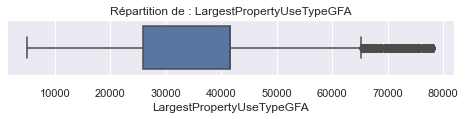

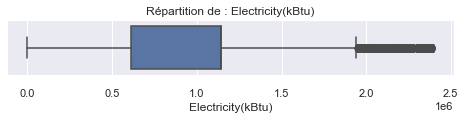

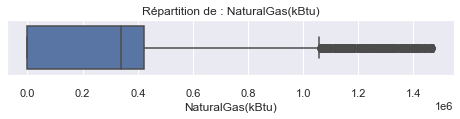

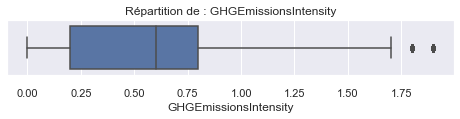

In [1093]:
NumVarBoxPlot(NumImputed)

Il y a toujours des valeurs abérentes. Corrigeons deux fois de plus

In [1094]:
CorrectionRepeat(NumImputed,2) ## 2 nouvelles corrections

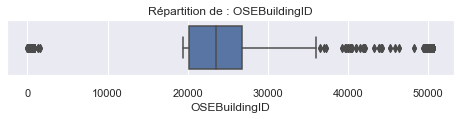

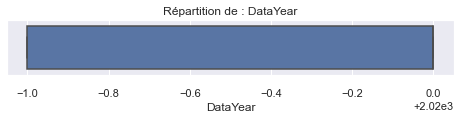

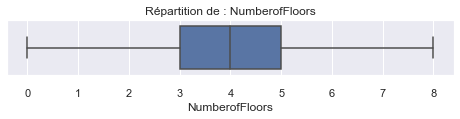

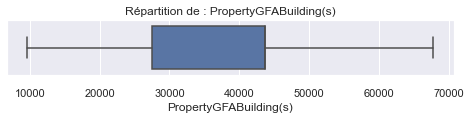

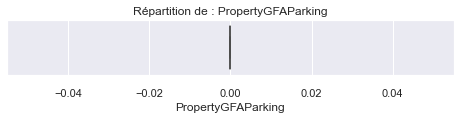

...

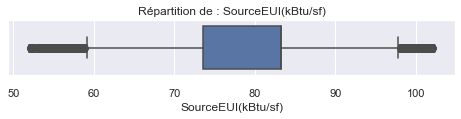

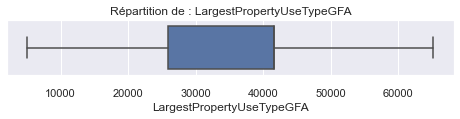

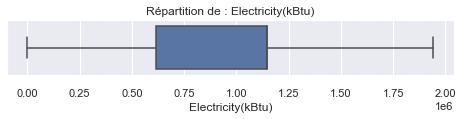

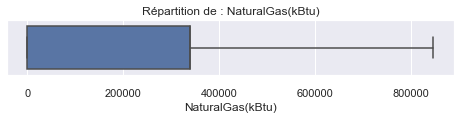

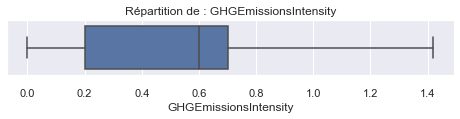

In [1096]:
NumVarBoxPlot(NumImputed)

In [1097]:
categorial_variables_modalities(CategorialData)

Multifamily          3815
NonResidential       3104
SPS-District K-12     198
Campus                 92
Name: BuildingType, dtype: int64
___________________________________________________________________________
Autres_TaxParcelIdentificationNumber    7209
Name: TaxParcelIdentificationNumber, dtype: int64
___________________________________________________________________________
DOWNTOWN                  1218
EAST                       971
MAGNOLIA / QUEEN ANNE      903
GREATER DUWAMISH           741
NORTHEAST                  645
LAKE UNION                 557
NORTHWEST                  441
SOUTHWEST                  355
NORTH                      302
BALLARD                    281
CENTRAL                    221
SOUTHEAST                  205
Autres_Neighborhood        202
DELRIDGE NEIGHBORHOODS     167
Name: Neighborhood, dtype: int64
___________________________________________________________________________
Multifamily Housing              3798
Autres_LargestPropertyUseType    10

### Encodage des variables catégorielles en numerical features

Les algorithmes d'apprentissage automatique ne peuvent pas travailler avec des données catégorielles directement, les données catégorielles doivent être converties en nombre. Pour cela, nous ferons appel aux méthodes d'encodage. Nous citons ci-après quelques-uns:

    1- Label Encoding (Encodage des étiquettes)
    2- One hot encoding (Encodage à chaud)
    3- Dummy variable trap (Encodage par variable fictive)
    4- Target encoding (Encodage de la cible)
    
Le **Label Encoding** consiste à transformer les modalités des variables en forme numérique afin que les algorithmes puissent comprendre comment opérer sur elles.

Un **One hot encoding** est une représentation des variables catégorielles sous forme de vecteurs binaires, ce qui permet de représenter les données catégorielles de manière plus expresive. Il faut d'abord que les valeurs catégorielles soient mappées en valeurs entières, c'est l'encodage par Label. Ensuite, chaque valeur entière est représentée comme un vecteur binaire composé de toutes les valeurs nulles, à l'exception de l'indice de l'entier, qui est marqué d'un 1.

Le piège de la **Dummy variable trap** est un scénario dans lequel les variables indépendantes sont multicollinéaires, un scénario dans lequel deux variables ou plus sont fortement corrélées, en termes simples : une variable peut être prédite à partir des autres.

En utilisant la fonction pandas get_dummies, nous pouvons effectuer les trois étapes ci-dessus en une seule ligne de code. Nous utiliserons cette fonction pour obtenir une variable fictive pour les caractéristiques sexe, enfants, fumeur, région. En définissant drop_first =True, la fonction supprimera le piège des variables fictives en supprimant une variable et la variable originale.


Le **Target encoding**
Dans le cas d'une cible catégorique, les caractéristiques sont remplacées par un mélange de la probabilité postérieure de la cible, compte tenu d'une valeur catégorique particulière, et de la probabilité antérieure de la cible sur toutes les données d'apprentissage.

Dans le cas d'une cible continue, les caractéristiques sont remplacées par un mélange de la valeur attendue de la cible pour une valeur catégorielle particulière et de la valeur attendue de la cible sur toutes les données d'apprentissage.

<br>Reférez-vous à ``category_encoders`` pour plus de détails ou à ce kaggle [link](https://www.kaggle.com/code/subinium/11-categorical-encoders-and-benchmark) 

In [1098]:
CategorialData_encode = pd.get_dummies(data=CategorialData, prefix='OHE', prefix_sep='_',
                          columns=CategorialData.columns,
                          drop_first=False,
                          dtype='int8',
                         )
CategorialData_encode

,OHE_Campus,OHE_Multifamily,OHE_NonResidential,OHE_SPS-District K-12,OHE_Autres_TaxParcelIdentificationNumber,OHE_Autres_Neighborhood,OHE_BALLARD,OHE_CENTRAL,OHE_DELRIDGE NEIGHBORHOODS,OHE_DOWNTOWN,...,OHE_Other,OHE_Retail Store,OHE_Worship Facility,OHE_Autres_ComplianceStatus,OHE_Compliant,OHE_Not Compliant,OHE_Account Requires Verification,OHE_Autres_ComplianceIssue,OHE_No Issue,OHE_Portfolio Manager Account Not Shared
0,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0
1,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0
2,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0
3,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0
4,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3623,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
3624,0,1,0,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
3625,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
3626,0,1,0,0,1,0,0,1,0,0,...,0,0,0,0,1,0,0,0,1,0


In [1099]:
CleanedData=pd.concat([NumImputed,CategorialData_encode],axis=1)

In [1100]:
CleanedData

,OSEBuildingID,DataYear,NumberofFloors,PropertyGFABuilding(s),PropertyGFAParking,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUseWN(kBtu),SourceEUI(kBtu/sf),LargestPropertyUseTypeGFA,...,OHE_Other,OHE_Retail Store,OHE_Worship Facility,OHE_Autres_ComplianceStatus,OHE_Compliant,OHE_Not Compliant,OHE_Account Requires Verification,OHE_Autres_ComplianceIssue,OHE_No Issue,OHE_Portfolio Manager Account Not Shared
0,1.0,2019.0,4.0,43645.0,0.0,62.0,36.1,1773587.0,83.3,41615.0,...,0,0,0,0,1,0,0,0,1,0
1,2.0,2019.0,4.0,43645.0,0.0,70.0,36.1,1773587.0,83.3,41615.0,...,0,0,0,0,1,0,0,0,1,0
2,3.0,2019.0,4.0,43645.0,0.0,64.0,36.1,1773587.0,83.3,41615.0,...,0,0,0,0,1,0,0,0,1,0
3,5.0,2019.0,4.0,61320.0,0.0,58.0,36.1,1773587.0,83.3,61320.0,...,0,0,0,0,1,0,0,0,1,0
4,8.0,2019.0,4.0,43645.0,0.0,63.0,36.1,1773587.0,83.3,41615.0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3623,50690.0,2020.0,6.0,43645.0,0.0,84.0,36.1,1773587.0,83.3,41615.0,...,0,0,0,0,1,0,0,0,1,0
3624,50692.0,2020.0,7.0,43645.0,0.0,67.2,27.5,1773587.0,70.9,41615.0,...,0,0,0,0,1,0,0,0,1,0
3625,50693.0,2020.0,3.0,20289.0,0.0,50.4,36.1,2111309.0,83.3,18289.0,...,0,0,0,0,1,0,0,0,1,0
3626,50694.0,2020.0,7.0,43645.0,0.0,74.0,47.9,1773587.0,85.3,41615.0,...,0,0,0,0,1,0,0,0,1,0


In [1101]:
CleanedData.to_csv('Clean_Data.csv', index=False)